In [9]:
from PIL import Image, ImageSequence
import numpy as np

In [10]:
image_path = "images/da_vinci.webp"
image = Image.open(image_path)
image_np = np.array(image.convert('L'))
image_np.shape

(1024, 1024)

In [11]:
U, S, Vt = np.linalg.svd(image_np)
print(U.shape, S.shape, Vt.shape)

(1024, 1024) (1024,) (1024, 1024)


In [12]:
image_sequence = []
k_values = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 15, 20, 30, 40, 50, 75, 100, 150, 300, 500, 800, 1024]

for k in k_values:
    U_k = U[:, :k]
    S_k = np.diag(S[:k])
    Vt_k = Vt[:k, :]
    new_image_np = U_k @ S_k @ Vt_k
    new_image = Image.fromarray(new_image_np.astype(np.uint8))
    image_sequence.append(new_image)

In [13]:
image_path = 'animations/da_vinci.gif'
image_sequence.extend(image_sequence[-1] for _ in range(8)) # stay on the final image for a bit
image_sequence[0].save(image_path, save_all=True, append_images=image_sequence[1:], duration=200, loop=0)

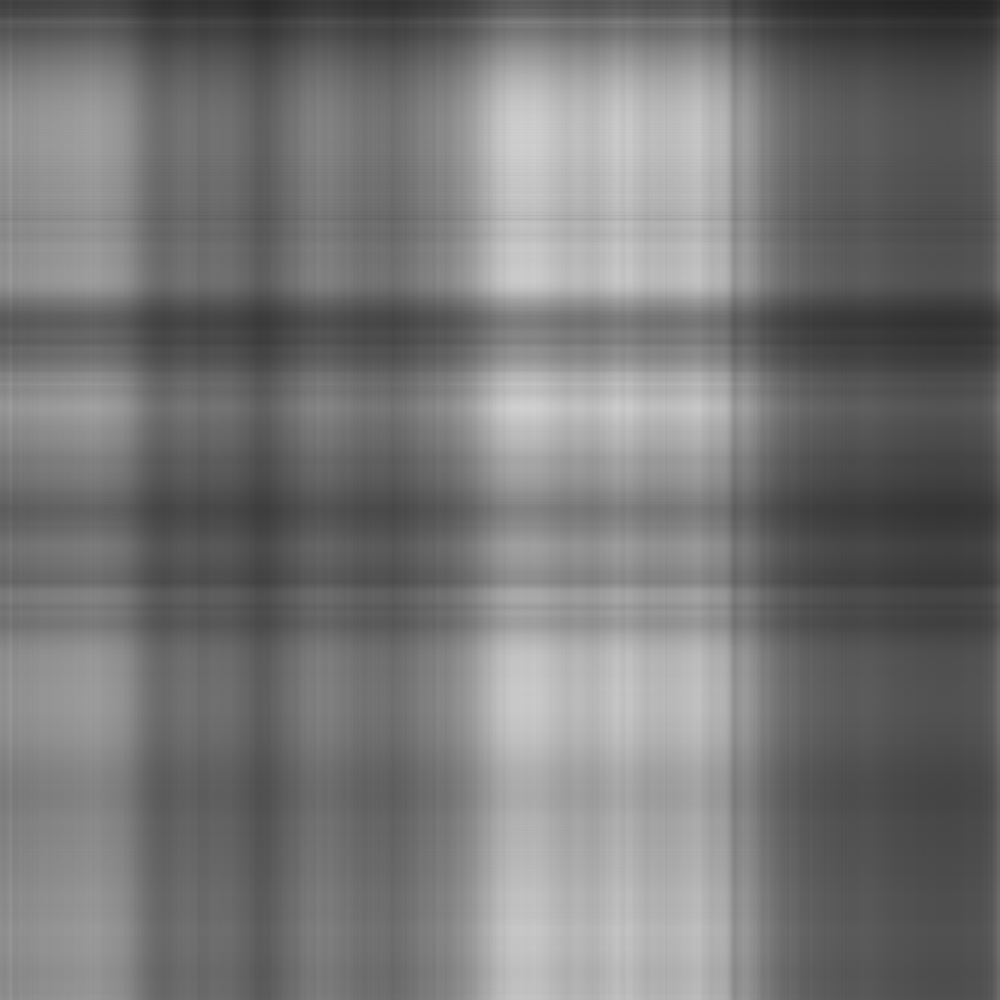

In [14]:
from IPython import display
display.Image(image_path, width=512, height=512)